# Importing the Library

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import f1_score
import re
import string


In [ ]:
import lstm
import importlib
from lstm import LSTM_Network
importlib.reload(lstm)

<module 'lstm' from 'd:\\Athaullah\\School\\ITB\\INFORMATIKA\\6th Semester\\ML\\tubes\\tubes-2\\src\\lstm.py'>

# Importing the Dataset

In [4]:
# NusaX-Sentiment (Bahasa Indonesia) dataset
nusax_train_df = pd.read_csv("dataset/nusaX/train.csv")
nusax_valid_df = pd.read_csv("dataset/nusaX/valid.csv")
nusax_test_df = pd.read_csv("dataset/nusaX/test.csv")

# Exploratory Data Analysis


In [5]:
print(f"NusaX train csv Shape: {nusax_train_df.shape}")
print(f"NusaX valid csv Shape: {nusax_valid_df.shape}")
print(f"NusaX test csv Shape: {nusax_test_df.shape}")
print(f"Columns: {nusax_train_df.columns.tolist()}")

print("\nLabel distribution in training set:")
print(nusax_train_df['label'].value_counts())

print("\nLabel distribution in validation set:")
print(nusax_valid_df['label'].value_counts())

print("\nLabel distribution in test set:")
print(nusax_test_df['label'].value_counts())

NusaX train csv Shape: (500, 3)
NusaX valid csv Shape: (100, 3)
NusaX test csv Shape: (400, 3)
Columns: ['id', 'text', 'label']

Label distribution in training set:
label
negative    192
positive    189
neutral     119
Name: count, dtype: int64

Label distribution in validation set:
label
negative    38
positive    38
neutral     24
Name: count, dtype: int64

Label distribution in test set:
label
negative    153
positive    151
neutral      96
Name: count, dtype: int64


# Preprocessing


In [10]:
def preprocess_text(text):
    # cleaning and preprocessing text 
    text = text.lower()
    text = text.translate(str.maketrans('', '', string.punctuation))
    text = ' '.join(text.split())
    return text

def create_tokenizer(texts, vocab_size=10000):
    # tokinzer 
    tokenizer = keras.preprocessing.text.Tokenizer(
        num_words=vocab_size,
        oov_token="<OOV>"
    )
    tokenizer.fit_on_texts(texts)
    return tokenizer

def pad_sequences(sequences, maxlen=100):
    # padding sequences to a fixed length
    return keras.preprocessing.sequence.pad_sequences(
        sequences, maxlen=maxlen, padding='post', truncating='post'
    )

In [12]:
train_texts = nusax_train_df['text'].tolist()
train_labels = nusax_train_df['label'].tolist()

valid_texts = nusax_valid_df['text'].tolist()
valid_labels = nusax_valid_df['label'].tolist()

test_texts = nusax_test_df['text'].tolist()
test_labels = nusax_test_df['label'].tolist()

all_labels = set(train_labels + valid_labels + test_labels)
all_texts = train_texts + valid_texts + test_texts

unique_labels = sorted(list(all_labels))
print(f"\nUnique labels found: {unique_labels}")

label_mapping = {label: idx-1 for idx, label in enumerate(unique_labels)}
print(f"Label mapping: {label_mapping}")

train_labels_num = [label_mapping[label] for label in train_labels]
valid_labels_num = [label_mapping[label] for label in valid_labels]
test_labels_num = [label_mapping[label] for label in test_labels]

processed_train_texts = [preprocess_text(text) for text in train_texts]
processed_valid_texts = [preprocess_text(text) for text in valid_texts]
processed_test_texts = [preprocess_text(text) for text in test_texts]
processed_all_texts = [preprocess_text(text) for text in all_texts]

tokenizer = create_tokenizer(processed_all_texts, vocab_size=5000)

train_sequences = tokenizer.texts_to_sequences(processed_train_texts)
valid_sequences = tokenizer.texts_to_sequences(processed_valid_texts)
test_sequences = tokenizer.texts_to_sequences(processed_test_texts)

X_train = pad_sequences(train_sequences, maxlen=50)
X_val = pad_sequences(valid_sequences, maxlen=50)
X_test = pad_sequences(test_sequences, maxlen=50)

y_train = np.array(train_labels_num)
y_val = np.array(valid_labels_num)
y_test = np.array(test_labels_num)

vocab_size = len(tokenizer.word_index) + 1
embedding_dim = 100
num_classes = len(label_mapping)

print(f"Vocabulary size: {vocab_size}")
print(f"Number of classes: {num_classes}")
print(f"Training samples: {len(X_train)}")
print(f"Validation samples: {len(X_val)}")
print(f"Test samples: {len(X_test)}")


Unique labels found: ['negative', 'neutral', 'positive']
Label mapping: {'negative': -1, 'neutral': 0, 'positive': 1}
Vocabulary size: 4353
Number of classes: 3
Training samples: 500
Validation samples: 100
Test samples: 400


# Pengujian

In [5]:
#1. Pengaruh hyperparameter
#1.1. Pengaruh depth
m1 =  FFNN(2, [5, 5], ["sigmoid", "sigmoid", "sigmoid"], x_train.shape[1], x_train.to_numpy().astype(float), 10, y_train.astype(float), 1, 0, 0, 0, "categorical_crossentropy")
tl1, vl1 = m1.fit(100, 0.3, 5, 0, x_test.to_numpy().astype(float), y_test.astype(float))
# m1.visualisasi()

m2 =  FFNN(5, [5, 5, 5, 5, 5], ["sigmoid", "sigmoid", "sigmoid", "sigmoid", "sigmoid", "sigmoid"], x_train.shape[1], x_train.to_numpy().astype(float), 10, y_train.astype(float), 1, 0, 0, 0, "categorical_crossentropy")
tl2, vl2 = m2.fit(100, 0.3, 5, 0, x_test.to_numpy().astype(float), y_test.astype(float))
# m2.visualisasi()

m3 =  FFNN(10, [5, 5, 5, 5, 5, 5, 5, 5, 5, 5], ["sigmoid", "sigmoid", "sigmoid", "sigmoid", "sigmoid", "sigmoid", "sigmoid", "sigmoid", "sigmoid", "sigmoid", "sigmoid"], x_train.shape[1], x_train.to_numpy().astype(float), 10, y_train.astype(float), 1, 0, 0, 0, "categorical_crossentropy")
tl3, vl3 = m3.fit(100, 0.3, 5, 0, x_test.to_numpy().astype(float), y_test.astype(float))
# m3.visualisasi()

100%|██████████| 5/5 [00:28<00:00,  5.75s/it]


Training finished
Training loss history
    1: 550.9858553943014
    2: 38.710803507638765
    3: 22.58643002059604
    4: 16.009552544933104
    5: 12.41148191740237

Validation loss history
    1: 13.977522741970352
    2: 6.963231065126887
    3: 4.636590902402875
    4: 3.475398800126989
    5: 2.779357441646007


100%|██████████| 5/5 [00:47<00:00,  9.47s/it]


Training finished
Training loss history
    1: 593.966311721407
    2: 38.202572566545655
    3: 22.250928270431107
    4: 15.770551240342922
    5: 12.22931132851517

Validation loss history
    1: 13.825122885881267
    2: 6.861752028647436
    3: 4.567097942434195
    4: 3.423885604904294
    5: 2.7390174972465875


100%|██████████| 5/5 [01:14<00:00, 14.80s/it]

Training finished
Training loss history
    1: 593.9663119263713
    2: 38.20257351045283
    3: 22.250929804901638
    4: 15.77055317788254
    5: 12.229313544745382

Validation loss history
    1: 13.825123028239526
    2: 6.861752346843186
    3: 4.567098381279311
    4: 3.4238861264725684
    5: 2.7390180764893404


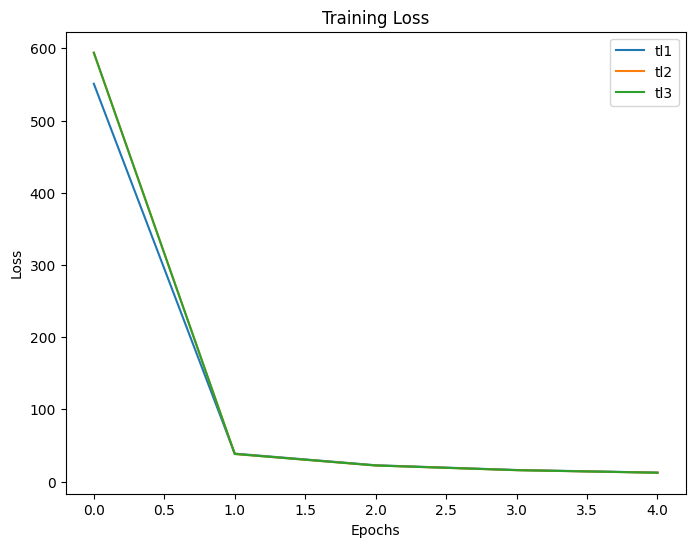

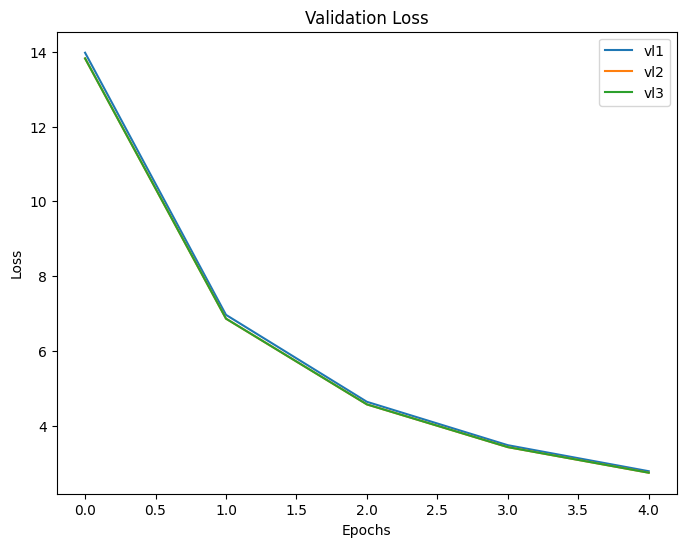

In [6]:
# loss graph
plt.figure(figsize=(8, 6))
plt.plot(tl1, label='tl1')
plt.plot(tl2, label='tl2')
plt.plot(tl3, label='tl3')
plt.title("Training Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()               

plt.figure(figsize=(8, 6))
plt.plot(vl1, label='vl1')
plt.plot(vl2, label='vl2')
plt.plot(vl3, label='vl3')
plt.title("Validation Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()  

In [7]:
#1.2. Pengaruh width
m1 =  FFNN(3, [10, 10, 10], ["sigmoid", "sigmoid", "sigmoid", "softmax"], x_train.shape[1], x_train.to_numpy().astype(float), 10, y_train.astype(float), 1, 0, 0, 0, "categorical_crossentropy")
tl1, vl1 = m1.fit(100, 0.3, 5, 0, x_test.to_numpy().astype(float), y_test.astype(float))
# m1.visualisasi()

m2 =  FFNN(3, [25, 25, 25], ["sigmoid", "sigmoid", "sigmoid", "softmax"], x_train.shape[1], x_train.to_numpy().astype(float),  10, y_train.astype(float), 1, 0, 0, 0, "categorical_crossentropy")
tl2, vl2 = m2.fit(100, 0.3, 5, 0, x_test.to_numpy().astype(float), y_test.astype(float))
# m2.visualisasi()

m3 =  FFNN(3, [50, 50, 50], ["sigmoid", "sigmoid", "sigmoid", "softmax"], x_train.shape[1], x_train.to_numpy().astype(float), 10, y_train.astype(float), 1, 0, 0, 0, "categorical_crossentropy")
tl3, vl3 = m3.fit(100, 0.3, 5, 0, x_test.to_numpy().astype(float), y_test.astype(float))
# m3.visualisasi()

100%|██████████| 5/5 [00:51<00:00, 10.31s/it]


Training finished
Training loss history
    1: 214798.45816881262
    2: 246592.3781041796
    3: 274826.6404333436
    4: 295669.3435129425
    5: 295669.34649515926

Validation loss history
    1: 57639.10201125091
    2: 62537.47593177925
    3: 70440.23409041738
    4: 70440.2348466612
    5: 70440.2352137216


100%|██████████| 5/5 [01:43<00:00, 20.64s/it]


Training finished
Training loss history
    1: 432883.7073472939
    2: 518644.18035855185
    3: 518644.1651369194
    4: 518644.17957359273
    5: 518644.18542578083

Validation loss history
    1: 140895.5812283561
    2: 140896.63124971048
    3: 140896.64144374095
    4: 140896.64505742467
    5: 140896.64673849964


100%|██████████| 5/5 [02:40<00:00, 32.14s/it]

Training finished
Training loss history
    1: 1129229.6406343326
    2: 1269333.682530721
    3: 1269673.1070670064
    4: 1269870.2687575638
    5: 1268946.513316405

Validation loss history
    1: 311091.7777839059
    2: 311183.8589597818
    3: 311183.84696077474
    4: 311188.95442029595
    5: 311183.82980977057


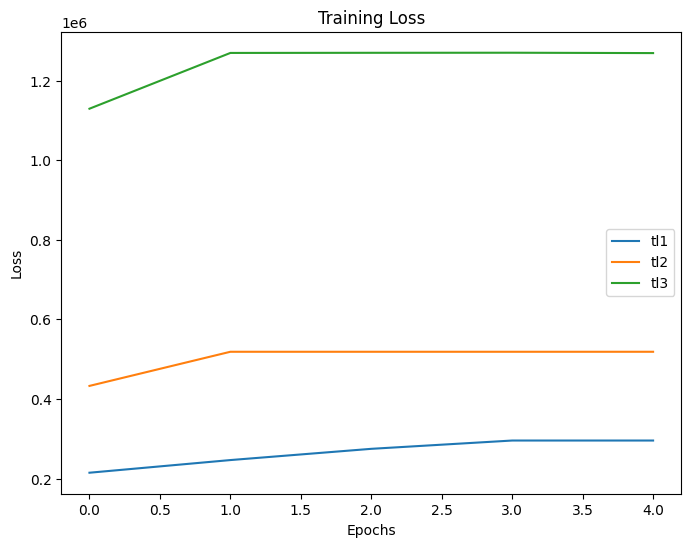

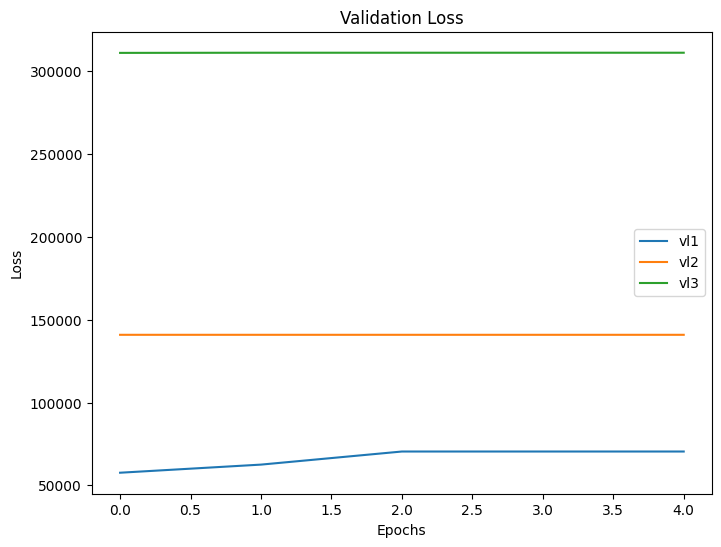

In [8]:
# loss graph
plt.figure(figsize=(8, 6))
plt.plot(tl1, label='tl1')
plt.plot(tl2, label='tl2')
plt.plot(tl3, label='tl3')
plt.title("Training Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()               

plt.figure(figsize=(8, 6))
plt.plot(vl1, label='vl1')
plt.plot(vl2, label='vl2')
plt.plot(vl3, label='vl3')
plt.title("Validation Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()  

In [9]:
#2. Pengaruh fungsi aktivasi hidden layer
m1 =  FFNN(3, [50, 50, 50], ["linear", "linear", "linear", "linear"], x_train.shape[1], x_train.to_numpy().astype(float), 10, y_train.astype(float), 1, 0, 0, 0, "categorical_crossentropy")
tl1, vl1 = m1.fit(100, 0.3, 5, 0, x_test.to_numpy().astype(float), y_test.astype(float))
# m1.visualisasi()

m2 =  FFNN(3, [50, 50, 50], ["relu", "relu", "relu", "relu"], x_train.shape[1], x_train.to_numpy().astype(float), 10, y_train.astype(float), 1, 0, 0, 0, "categorical_crossentropy")
tl2, vl2 = m2.fit(100, 0.3, 5, 0, x_test.to_numpy().astype(float), y_test.astype(float))
# m2.visualisasi()

m3 =  FFNN(3, [50, 50, 50], ["sigmoid", "sigmoid", "sigmoid", "sigmoid"], x_train.shape[1], x_train.to_numpy().astype(float), 10, y_train.astype(float), 1, 0, 0, 0, "categorical_crossentropy")
tl3, vl3 = m3.fit(100, 0.3, 5, 0, x_test.to_numpy().astype(float), y_test.astype(float))
# m3.visualisasi()

m4 =  FFNN(3, [50, 50, 50], ["tanh", "tanh", "tanh", "tanh"], x_train.shape[1], x_train.to_numpy().astype(float), 10, y_train.astype(float), 1, 0, 0, 0, "categorical_crossentropy")
tl4, vl4 = m4.fit(100, 0.3, 5, 0, x_test.to_numpy().astype(float), y_test.astype(float))
# m4.visualisasi()

100%|██████████| 5/5 [02:19<00:00, 27.83s/it]


Training finished
Training loss history
    1: 2763.102111648753
    2: 5.5998761183701234e-08
    3: 5.5998761183701234e-08
    4: 5.5998761183701234e-08
    5: 5.5998761183701234e-08

Validation loss history
    1: 1.3999690295925304e-08
    2: 1.3999690295925304e-08
    3: 1.3999690295925304e-08
    4: 1.3999690295925304e-08
    5: 1.3999690295925304e-08


100%|██████████| 5/5 [02:18<00:00, 27.62s/it]


Training finished
Training loss history
    1: 1547337.1824920005
    2: 1547337.1824920005
    3: 1547337.1824920005
    4: 1547337.1824920005
    5: 1547337.1824920005

Validation loss history
    1: 386834.2956229996
    2: 386834.2956229996
    3: 386834.2956229996
    4: 386834.2956229996
    5: 386834.2956229996


100%|██████████| 5/5 [02:31<00:00, 30.25s/it]


Training finished
Training loss history
    1: 149.08698948566024
    2: 4.6266077653683135
    3: 2.6076764393674026
    4: 1.8180855701888392
    5: 1.3956014470713292

Validation loss history
    1: 1.7147738383240554
    2: 0.8128779460236911
    3: 0.5298366302379678
    4: 0.39236104685080353
    5: 0.3113302092809053


100%|██████████| 5/5 [02:15<00:00, 27.19s/it]

Training finished
Training loss history
    1: 2763.102111648753
    2: 5.5998761183701234e-08
    3: 5.5998761183701234e-08
    4: 5.5998761183701234e-08
    5: 5.5998761183701234e-08

Validation loss history
    1: 1.3999690295925304e-08
    2: 1.3999690295925304e-08
    3: 1.3999690295925304e-08
    4: 1.3999690295925304e-08
    5: 1.3999690295925304e-08


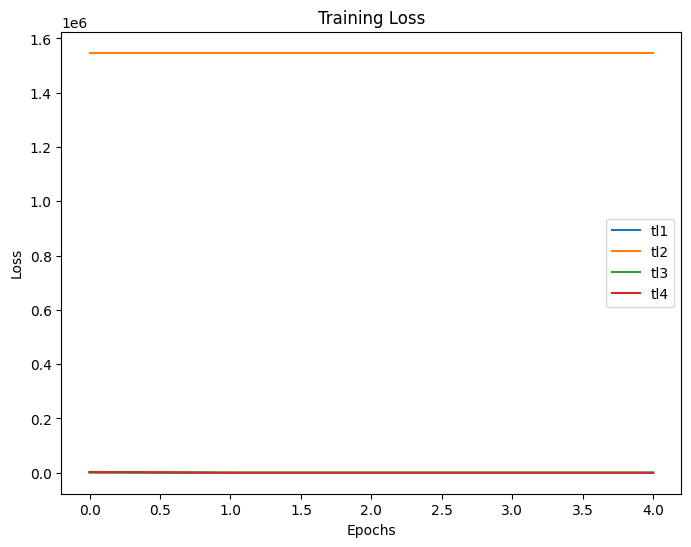

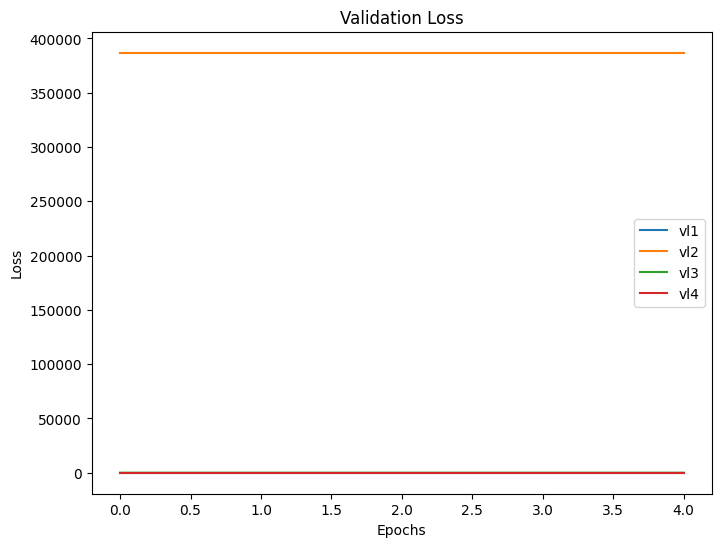

In [10]:
# loss graph
plt.figure(figsize=(8, 6))
plt.plot(tl1, label='tl1')
plt.plot(tl2, label='tl2')
plt.plot(tl3, label='tl3')
plt.plot(tl4, label='tl4')
plt.title("Training Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()               

plt.figure(figsize=(8, 6))
plt.plot(vl1, label='vl1')
plt.plot(vl2, label='vl2')
plt.plot(vl3, label='vl3')
plt.plot(vl4, label='vl4')
plt.title("Validation Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()  

In [12]:
#3. Pengaruh learning rate
m1 =  FFNN(3, [10, 10, 10], ["sigmoid", "sigmoid", "sigmoid", "sigmoid"], x_train.shape[1], x_train.to_numpy().astype(float), 10, y_train.astype(float), 1, 0, 0, 0, "categorical_crossentropy")
tl1, vl1 = m1.fit(100, 0.2, 5, 0, x_test.to_numpy().astype(float), y_test.astype(float))
# m1.visualisasi()

m2 =  FFNN(3, [10, 10, 10], ["sigmoid", "sigmoid", "sigmoid", "sigmoid"], x_train.shape[1], x_train.to_numpy().astype(float), 10, y_train.astype(float), 1, 0, 0, 0, "categorical_crossentropy")
tl2, vl2 = m2.fit(100, 0.5, 5, 0, x_test.to_numpy().astype(float), y_test.astype(float))
# m2.visualisasi()

m3 =  FFNN(3, [10, 10, 10], ["sigmoid", "sigmoid", "sigmoid", "sigmoid"], x_train.shape[1], x_train.to_numpy().astype(float), 10, y_train.astype(float), 1, 0, 0, 0, "categorical_crossentropy")
tl3, vl3 = m3.fit(100, 0.8, 5, 0, x_test.to_numpy().astype(float), y_test.astype(float))
# m3.visualisasi()

100%|██████████| 5/5 [00:39<00:00,  7.92s/it]


Training finished
Training loss history
    1: 558.3205820321632
    2: 30.816152082831792
    3: 17.963847848351286
    4: 12.745037283519787
    5: 9.891581566687288

Validation loss history
    1: 11.153546990485859
    2: 5.536955951171733
    3: 3.6892387754164053
    4: 2.768333534875968
    5: 2.216281297614493


100%|██████████| 5/5 [00:42<00:00,  8.50s/it]


Training finished
Training loss history
    1: 253.4218569230654
    2: 12.148098392994484
    3: 7.134972208698016
    4: 5.077001636346943
    5: 3.9464529343872243

Validation loss history
    1: 4.367806152278996
    2: 2.1944745337985565
    3: 1.46808536570721
    4: 1.1038189539494112
    5: 0.8847312470265695


100%|██████████| 5/5 [00:40<00:00,  8.19s/it]

Training finished
Training loss history
    1: 173.82425889504498
    2: 7.513923507597056
    3: 4.428665575323483
    4: 3.156183383081483
    5: 2.4555902131783354

Validation loss history
    1: 2.693846882172215
    2: 1.3606444786541048
    3: 0.912126657158603
    4: 0.6865743403512334
    5: 0.5506958789037345


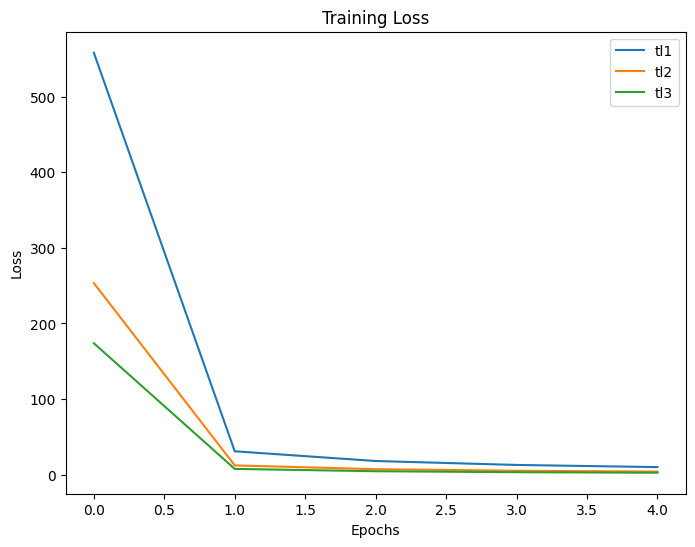

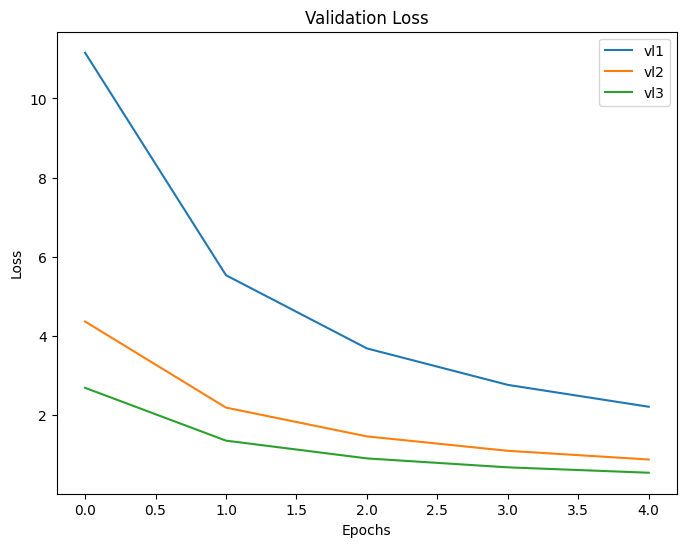

In [13]:
# loss graph
plt.figure(figsize=(8, 6))
plt.plot(tl1, label='tl1')
plt.plot(tl2, label='tl2')
plt.plot(tl3, label='tl3')
plt.title("Training Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()               

plt.figure(figsize=(8, 6))
plt.plot(vl1, label='vl1')
plt.plot(vl2, label='vl2')
plt.plot(vl3, label='vl3')
plt.title("Validation Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()  

In [14]:
#4. Pengaruh inisialisasi bobot
m1 =  FFNN(3, [10, 10, 10], ["sigmoid", "sigmoid", "sigmoid", "sigmoid"], x_train.shape[1], x_train.to_numpy().astype(float), 10, y_train.astype(float), 1, 0, 0, 0, "categorical_crossentropy")
tl1, vl1 = m1.fit(100, 0.2, 5, 0, x_test.to_numpy().astype(float), y_test.astype(float))
# m1.visualisasi()

m2 =  FFNN(3, [10, 10, 10], ["sigmoid", "sigmoid", "sigmoid", "sigmoid"], x_train.shape[1], x_train.to_numpy().astype(float), 10, y_train.astype(float), 2, 0, 7, 11111, "categorical_crossentropy")
tl2, vl2 = m2.fit(100, 0.2, 5, 0, x_test.to_numpy().astype(float), y_test.astype(float))
# m2.visualisasi()

m3 =  FFNN(3, [10, 10, 10], ["sigmoid", "sigmoid", "sigmoid", "sigmoid"], x_train.shape[1], x_train.to_numpy().astype(float), 10, y_train.astype(float), 3, 0, 7, 11111, "categorical_crossentropy")
tl3, vl3 = m3.fit(100, 0.2, 5, 0, x_test.to_numpy().astype(float), y_test.astype(float))
# m3.visualisasi()

100%|██████████| 5/5 [00:41<00:00,  8.37s/it]


Training finished
Training loss history
    1: 558.3205820321632
    2: 30.816152082831792
    3: 17.963847848351286
    4: 12.745037283519787
    5: 9.891581566687288

Validation loss history
    1: 11.153546990485859
    2: 5.536955951171733
    3: 3.6892387754164053
    4: 2.768333534875968
    5: 2.216281297614493


100%|██████████| 5/5 [00:40<00:00,  8.06s/it]


Training finished
Training loss history
    1: 5.5998761183701234e-08
    2: 5.5998761183701234e-08
    3: 5.5998761183701234e-08
    4: 5.5998761183701234e-08
    5: 5.5998761183701234e-08

Validation loss history
    1: 1.3999690295925304e-08
    2: 1.3999690295925304e-08
    3: 1.3999690295925304e-08
    4: 1.3999690295925304e-08
    5: 1.3999690295925304e-08


  0%|          | 0/5 [00:00<?, ?it/s]d:\Athaullah\School\ITB\INFORMATIKA\6th Semester\ML\tubes\tubes-1\src\activationfunctions.py:17: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-x))
100%|██████████| 5/5 [00:43<00:00,  8.68s/it]

Training finished
Training loss history
    1: 4229.133013821329
    2: 119.90236450898266
    3: 46.81135130050349
    4: 25.12443451352758
    5: 19.8681668875551

Validation loss history
    1: 51.597377698929
    2: 19.774498207317535
    3: 8.716479456935344
    4: 6.987191442388628
    5: 5.997296047138594


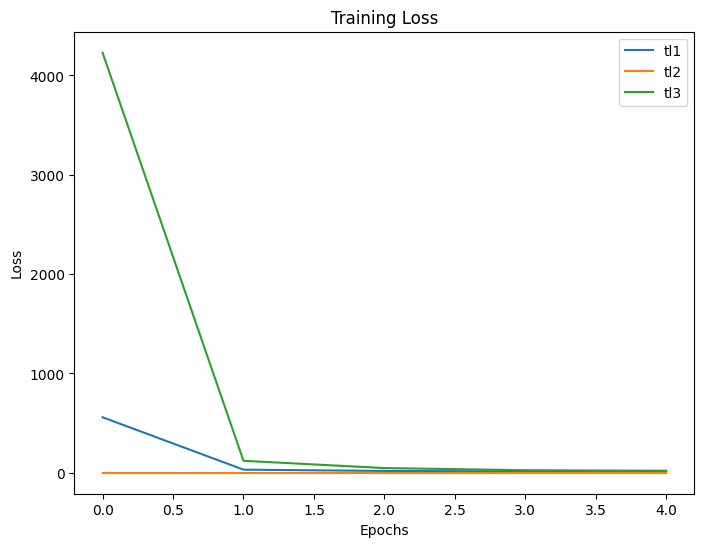

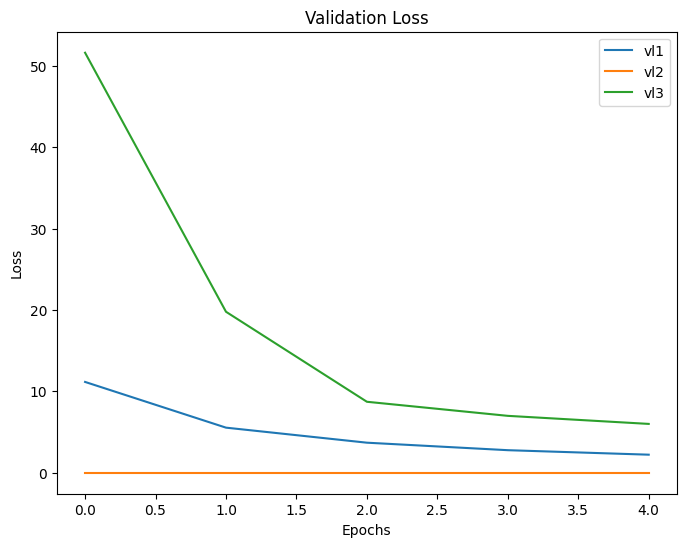

In [15]:
# loss graph
plt.figure(figsize=(8, 6))
plt.plot(tl1, label='tl1')
plt.plot(tl2, label='tl2')
plt.plot(tl3, label='tl3')
plt.title("Training Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()               

plt.figure(figsize=(8, 6))
plt.plot(vl1, label='vl1')
plt.plot(vl2, label='vl2')
plt.plot(vl3, label='vl3')
plt.title("Validation Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()  

In [20]:
import ffnn
import importlib
from ffnn import FFNN
importlib.reload(ffnn)


<module 'ffnn' from 'd:\\Athaullah\\School\\ITB\\INFORMATIKA\\6th Semester\\ML\\tubes\\tubes-1\\src\\ffnn.py'>

In [22]:
#1.5. Pengaruh regularisasi
m1 =  FFNN(3, [10, 10, 10], ["sigmoid", "sigmoid", "sigmoid", "softmax"], x_train.shape[1], x_train.to_numpy().astype(float), 10, y_train.astype(float), 1, 0, 0, 0, "categorical_crossentropy", 0.1, 0)
tl1, vl1 = m1.fit(100, 0.3, 5, 0, x_test.to_numpy().astype(float), y_test.astype(float))
# m1.visualize_model()

m2 =  FFNN(3, [10, 10, 10], ["sigmoid", "sigmoid", "sigmoid", "softmax"], x_train.shape[1], x_train.to_numpy().astype(float),  10, y_train.astype(float), 1, 0, 0, 0, "categorical_crossentropy", 0, 0.1)
tl2, vl2 = m2.fit(100, 0.3, 5, 0, x_test.to_numpy().astype(float), y_test.astype(float))
# m2.visualize_model()

  0%|          | 0/5 [00:00<?, ?it/s]d:\Athaullah\School\ITB\INFORMATIKA\6th Semester\ML\tubes\tubes-1\src\activationfunctions.py:17: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-x))


mau loss
[[0. 0. 0. ... 0. 0. 1.]
 [0. 0. 0. ... 1. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]]
[array([0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1]), array([0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1]), array([0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1]), array([0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1]), array([0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1]), array([0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1]), array([0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1]), array([0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1]), array([0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1]), array([0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1]), array([0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1]), array([0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1]), array([0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1]), array([0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1]), array([0

 20%|██        | 1/5 [00:14<00:59, 14.86s/it]

mau loss
[[0. 0. 0. ... 0. 0. 1.]
 [0. 0. 0. ... 1. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]]
[array([0.11527257, 0.21084975, 0.06173718, 0.11494044, 0.05596204,
       0.00910705, 0.14287522, 0.10462809, 0.09896859, 0.08565908]), array([0.11527257, 0.21084975, 0.06173718, 0.11494044, 0.05596204,
       0.00910705, 0.14287522, 0.10462809, 0.09896859, 0.08565908]), array([0.11527257, 0.21084975, 0.06173718, 0.11494044, 0.05596204,
       0.00910705, 0.14287522, 0.10462809, 0.09896859, 0.08565908]), array([0.11527257, 0.21084975, 0.06173718, 0.11494044, 0.05596204,
       0.00910705, 0.14287522, 0.10462809, 0.09896859, 0.08565908]), array([0.11527257, 0.21084975, 0.06173718, 0.11494044, 0.05596204,
       0.00910705, 0.14287522, 0.10462809, 0.09896859, 0.08565908]), array([0.11527257, 0.21084975, 0.06173718, 0.11494044, 0.05596204,
       0.00910705, 0.14287522, 0.10462809, 0.09896859, 0.08565908]), array([0.11527257,

 40%|████      | 2/5 [00:29<00:44, 14.68s/it]

mau loss
[[0. 0. 0. ... 0. 0. 1.]
 [0. 0. 0. ... 1. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]]
[array([0.09302853, 0.23202317, 0.05988097, 0.11062026, 0.05910822,
       0.0048543 , 0.13188724, 0.09748482, 0.11157003, 0.09954246]), array([0.09302853, 0.23202317, 0.05988097, 0.11062026, 0.05910822,
       0.0048543 , 0.13188724, 0.09748482, 0.11157003, 0.09954246]), array([0.09302853, 0.23202317, 0.05988097, 0.11062026, 0.05910822,
       0.0048543 , 0.13188724, 0.09748482, 0.11157003, 0.09954246]), array([0.09302853, 0.23202317, 0.05988097, 0.11062026, 0.05910822,
       0.0048543 , 0.13188724, 0.09748482, 0.11157003, 0.09954246]), array([0.09302853, 0.23202317, 0.05988097, 0.11062026, 0.05910822,
       0.0048543 , 0.13188724, 0.09748482, 0.11157003, 0.09954246]), array([0.09302853, 0.23202317, 0.05988097, 0.11062026, 0.05910822,
       0.0048543 , 0.13188724, 0.09748482, 0.11157003, 0.09954246]), array([0.09302853,

 60%|██████    | 3/5 [00:44<00:29, 14.93s/it]

mau loss
[[0. 0. 0. ... 0. 0. 1.]
 [0. 0. 0. ... 1. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]]
[array([0.09329257, 0.23219756, 0.06003788, 0.11081262, 0.05936192,
       0.00310432, 0.1321359 , 0.09759575, 0.11175649, 0.09970499]), array([0.09329257, 0.23219756, 0.06003788, 0.11081262, 0.05936192,
       0.00310432, 0.1321359 , 0.09759575, 0.11175649, 0.09970499]), array([0.09329257, 0.23219756, 0.06003788, 0.11081262, 0.05936192,
       0.00310432, 0.1321359 , 0.09759575, 0.11175649, 0.09970499]), array([0.09329257, 0.23219756, 0.06003788, 0.11081262, 0.05936192,
       0.00310432, 0.1321359 , 0.09759575, 0.11175649, 0.09970499]), array([0.09329257, 0.23219756, 0.06003788, 0.11081262, 0.05936192,
       0.00310432, 0.1321359 , 0.09759575, 0.11175649, 0.09970499]), array([0.09329257, 0.23219756, 0.06003788, 0.11081262, 0.05936192,
       0.00310432, 0.1321359 , 0.09759575, 0.11175649, 0.09970499]), array([0.09329257,

 80%|████████  | 4/5 [00:59<00:14, 14.98s/it]

mau loss
[[0. 0. 0. ... 0. 0. 1.]
 [0. 0. 0. ... 1. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]]
[array([0.0933984 , 0.23228608, 0.06011705, 0.11091325, 0.05946719,
       0.00224013, 0.13226297, 0.0976533 , 0.11185727, 0.09980436]), array([0.0933984 , 0.23228608, 0.06011705, 0.11091325, 0.05946719,
       0.00224013, 0.13226297, 0.0976533 , 0.11185727, 0.09980436]), array([0.0933984 , 0.23228608, 0.06011705, 0.11091325, 0.05946719,
       0.00224013, 0.13226297, 0.0976533 , 0.11185727, 0.09980436]), array([0.0933984 , 0.23228608, 0.06011705, 0.11091325, 0.05946719,
       0.00224013, 0.13226297, 0.0976533 , 0.11185727, 0.09980436]), array([0.0933984 , 0.23228608, 0.06011705, 0.11091325, 0.05946719,
       0.00224013, 0.13226297, 0.0976533 , 0.11185727, 0.09980436]), array([0.0933984 , 0.23228608, 0.06011705, 0.11091325, 0.05946719,
       0.00224013, 0.13226297, 0.0976533 , 0.11185727, 0.09980436]), array([0.0933984 ,

100%|██████████| 5/5 [01:14<00:00, 14.94s/it]


Training finished
Training loss history
    1: 180907.57558340958
    2: 706484.2889892241
    3: 769603.3438882997
    4: 770514.7011039321
    5: 675315.5392287627

Validation loss history
    1: 35156.548656159815
    2: 35969.750681440964
    3: 36523.82632162353
    4: 36934.42262111208
    5: 37432.154792351444


  0%|          | 0/5 [00:00<?, ?it/s]


TypeError: can't multiply sequence by non-int of type 'float'

In [ ]:
# loss graph
plt.figure(figsize=(8, 6))
plt.plot(tl1, label='tl1')
plt.plot(tl2, label='tl2')
plt.plot(tl3, label='tl3')
plt.title("Training Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()               

plt.figure(figsize=(8, 6))
plt.plot(vl1, label='vl1')
plt.plot(vl2, label='vl2')
plt.plot(vl3, label='vl3')
plt.title("Validation Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()  

In [23]:
import ffnn
import importlib
from ffnn import FFNN
importlib.reload(ffnn)

<module 'ffnn' from 'd:\\Athaullah\\School\\ITB\\INFORMATIKA\\6th Semester\\ML\\tubes\\tubes-1\\src\\ffnn.py'>

In [16]:
#2. Perbandingan dengan library sklearn
# clf0 =  FFNN(2, [128, 64], ["sigmoid", "sigmoid", "softmax"], x_train_norm.shape[1], x_train_norm.to_numpy().astype(float), 10, y_train_norm.astype(float), 5, 0, 0, 69, "categorical_crossentropy")
# clf0.fit(64, 0.3, 5, 0, x_train_norm.to_numpy().astype(float), y_train_norm.astype(float))

clf0 =  FFNN(3, [10, 10, 10], ["sigmoid", "sigmoid", "sigmoid", "softmax"], x_train.shape[1], x_train.to_numpy().astype(float), 10, y_train.astype(float), 1, 0, 0, 0, "categorical_crossentropy")
clf0.fit(100, 0.5, 5, 0, x_test.to_numpy().astype(float), y_test.astype(float))

100%|██████████| 5/5 [00:46<00:00,  9.27s/it]

Training finished
Training loss history
    1: 301801.94170777575
    2: 348027.88430840254
    3: 348027.91479745274
    4: 348027.9225368157
    5: 348027.92564212886

Validation loss history
    1: 81855.3958010948
    2: 81855.4130511762
    3: 81855.41631950937
    4: 81855.41746828065
    5: 81855.41800072373


([301801.94170777575,
  348027.88430840254,
  348027.91479745274,
  348027.9225368157,
  348027.92564212886],
 [81855.3958010948,
  81855.4130511762,
  81855.41631950937,
  81855.41746828065,
  81855.41800072373])

In [17]:
output0 = clf0.pred(x_test.to_numpy().astype(float))
print(len(x_test))
print(len(output0))
output0_adj = []
for result in output0:
    mask = result == np.max(result)
    output0_adj.append(mask.astype(int))

print(accuracy_score(y_test, clf0.format_predictions(output0_adj)))

clf1 = MLPClassifier(solver='sgd', hidden_layer_sizes=(10,), random_state=1)
clf1.fit(x_train, y_train)   
output1 = clf1.predict(x_test)
print("sgd")
print(accuracy_score(y_test, output1))

clf2 = MLPClassifier(solver='lbfgs', hidden_layer_sizes=(10,), random_state=1)
clf2.fit(x_train, y_train)   
output2 = clf2.predict(x_test)
print("lbfgs")
print(accuracy_score(y_test, output2))

14000
14000
0.09507142857142857


c:\Python312\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:697: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


sgd
0.08635714285714285
lbfgs
0.0
